In [1]:
from datetime import date
import json

import pandas as pd
import numpy as np
import bcolz

from sklearn.model_selection import train_test_split
from sklearn.svm import LinearSVC

from tqdm.notebook import tqdm

import geohash

from helpers import get_labels, plot_, get_metrics, get_conf, plot_map, get_confusion_metrics, get_conf


# Exploration of methods for detection of locust in hopper stage in ethiopia, 2016-present
- Hopper data can be downloaded from [here](https://locust-hub-hqfao.hub.arcgis.com/datasets/969749ccd9f546d29730a60f72bebb42_0)
- Geohashes are downloaded for all geohashes in ethiopia for all months since 2016 in which a hopper has been sighted.
- Objective is to learn locations of hoppers from geohash/temporal features.

# Get Labels

In [2]:
from helpers import get_locusthub_df
df_hoppers = get_locusthub_df('/home/ebarnett/Locusts/Hoppers.csv')
df_hoppers

,gh,Y,X,date
32852,scee7,9.016111,38.812222,2016-09-16
32853,sfjq9,12.404167,41.183333,2016-09-24
32854,sfjq9,12.404167,41.183333,2016-09-24
33015,sfk74,13.223056,39.825000,2016-10-09
33016,sfjqf,12.466944,41.223611,2016-10-05
...,...,...,...,...
46822,sbg9c,4.561111,38.716944,2020-05-01
46823,sbg9b,4.544722,38.706667,2020-05-01
46832,sbg99,4.488889,38.719722,2020-05-02
46833,sbg99,4.488611,38.720000,2020-05-02


# Get Embeddings / Metadata
- Geohashes have been featurized using pretrained (moco) resnet50.
- Large scale of data, break up into 12 bcolz arrays. Read in as one for downstream tasks


In [3]:
for i in tqdm(range(12)):
    if i == 0:
        df_meta = pd.read_csv(f'/raid/users/ebarnett/locusts_eth_fts/meta_{i}.csv')
        Xn = np.array(bcolz.open(f'/raid/users/ebarnett/locusts_eth_fts/embs_{i}/'))

    else:
        df_ = pd.read_csv(f'/raid/users/ebarnett/locusts_eth_fts/meta_{i}.csv')
        df_meta = df_meta.append(df_).reset_index(drop=True)
        X = np.array(bcolz.open(f'/raid/users/ebarnett/locusts_eth_fts/embs_{i}/'))
        Xn = np.concatenate((Xn, X), axis=0)


# Normalize
Xn = Xn / np.sqrt((Xn ** 2).sum(axis=-1, keepdims=True))

# Remove corrupted if exist
drop_idx = np.unique(np.argwhere(np.isnan(Xn))[:,0])
Xn = np.delete(Xn, drop_idx, axis=0)
df_meta = df_meta.drop(drop_idx).reset_index(drop=True)

# Add missing info
df_meta['date'] = pd.to_datetime(df_meta.date)
df_meta['lat'] = df_meta.apply(lambda rec: geohash.decode(rec['geohash'])[1], axis=1)
df_meta['lon'] = df_meta.apply(lambda rec: geohash.decode(rec['geohash'])[0], axis=1)
df_meta = df_meta[['path', 'date', 'geohash', 'lat', 'lon']]
df_meta

,path,date,geohash,lat,lon
0,/raid/users/ebarnett/locusts_eth/sfjsv_2018-09...,2018-09-17,sfjsv,41.726074,12.106934
1,/raid/users/ebarnett/locusts_eth/sbzsy_2017-03...,2017-03-26,sbzsy,44.582520,5.075684
2,/raid/users/ebarnett/locusts_eth/scv8t_2018-02...,2018-02-19,scv8t,41.726074,9.953613
3,/raid/users/ebarnett/locusts_eth/scebz_2016-11...,2016-11-26,scebz,39.353027,8.591309
4,/raid/users/ebarnett/locusts_eth/t12wh_2018-09...,2018-09-17,t12wh,45.900879,8.107910
...,...,...,...,...,...
648187,/raid/users/ebarnett/locusts_eth/scqev_2019-06...,2019-06-14,scqev,43.132324,7.712402
648188,/raid/users/ebarnett/locusts_eth/sfjem_2018-11...,2018-11-16,sfjem,41.726074,11.843262
648189,/raid/users/ebarnett/locusts_eth/sc1tu_2017-11...,2017-11-21,sc1tu,36.057129,6.657715
648190,/raid/users/ebarnett/locusts_eth/sc1jw_2019-01...,2019-01-15,sc1jw,35.441895,6.613770


# Define Labels on the Meta
- Add positive labels to rows which match geohash and fall within daterange, 
- Extend the labels to neighboring geohashes using n_neighbor

In [4]:
df_label = get_labels(df_meta, df_hoppers, 'hoppers', n_neighbor = 2)
y = df_label['hoppers'].values

# Experiment : Random sample of some proportion, stratified by label
- Simplest possible framework
- Probably not realistic (dont get future data to predict past in real world).

In [5]:
X_train, X_valid, y_train, y_valid, idx_train, idx_valid = train_test_split(Xn, y, np.arange(Xn.shape[0]),
                                                           train_size=0.1, 
                                                           stratify=y, 
                                                           random_state=3)

# Do experiment with Linear SVM with regularization
model = LinearSVC(C=20, max_iter=5000).fit(X_train, y_train)
pred_valid = model.decision_function(X_valid)
pred_train = model.decision_function(X_train)
thresh = np.median(pred_train[y_train])
metrics_dict = get_metrics(pred_valid, y_valid, thresh)
print(metrics_dict)


{'top5': 0.8, 'top10': 0.5, 'top50': 0.26, 'top100': 0.28, 'top500': 0.128, 'top1000': 0.088, 'valid_auc': 0.6177160216845907, 'tp': 0.0, 'fp': 0.0, 'tn': 582604.0, 'fn': 769.0, 'prec': nan, 'rec': 0.0}


# Check what is being predicted - is it just the same locs? / is there leakage?

In [6]:
# Check top N predicted geohash/dates
N = 20
top_idx = pred_valid.argsort()[-N:][::-1]
df_val = df_label.iloc[idx_valid[top_idx]]
df_train = df_label.iloc[idx_train]
df_train.loc[df_train['geohash'].isin(df_val['geohash'])]

df_val


,path,date,geohash,lat,lon,hoppers
517357,/raid/users/ebarnett/locusts_eth/scy4h_2019-10...,2019-10-12,scy4h,42.385254,10.217285,1
493897,/raid/users/ebarnett/locusts_eth/scy47_2019-10...,2019-10-12,scy47,42.341309,10.261230,1
507204,/raid/users/ebarnett/locusts_eth/scy4j_2019-10...,2019-10-12,scy4j,42.429199,10.217285,1
365221,/raid/users/ebarnett/locusts_eth/scy4k_2019-10...,2019-10-12,scy4k,42.385254,10.261230,1
222593,/raid/users/ebarnett/locusts_eth/scy4h_2019-01...,2019-01-15,scy4h,42.385254,10.217285,0
340089,/raid/users/ebarnett/locusts_eth/scy4k_2019-01...,2019-01-15,scy4k,42.385254,10.261230,0
161347,/raid/users/ebarnett/locusts_eth/scy4m_2019-10...,2019-10-12,scy4m,42.429199,10.261230,1
173428,/raid/users/ebarnett/locusts_eth/scy47_2019-01...,2019-01-15,scy47,42.341309,10.261230,0
429988,/raid/users/ebarnett/locusts_eth/scy47_2017-12...,2017-12-21,scy47,42.341309,10.261230,0
444044,/raid/users/ebarnett/locusts_eth/scy4k_2017-12...,2017-12-21,scy4k,42.385254,10.261230,0


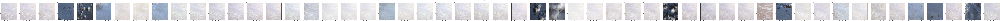

In [7]:
# Plot full sequence of a given example
row_sample = df_val.sample() 
gh = row_sample['geohash'].iloc[0]
dt = row_sample['date'].iloc[0]
d = df_label.loc[df_label['geohash'] == gh].sort_values(['date'], ascending=[1])
date_seq = []
for row in d.iterrows():
    date_seq.append({'event': row[1].hoppers,
     'path': row[1].path,
     'date': row[1].date,
     'pred': (row[1].date == dt),
     'in_train': len(df_train.loc[df_train['date'] == row[1].date].loc[df_train['geohash']==row[1].geohash]),
     'hopper_in_train': len(df_train.loc[df_train['date'] == row[1].date].loc[df_train['geohash']==row[1].geohash].loc[df_train['hoppers']==1])})

plot_(date_seq, title=gh)


# Have a look at the map / Distribution of predictions

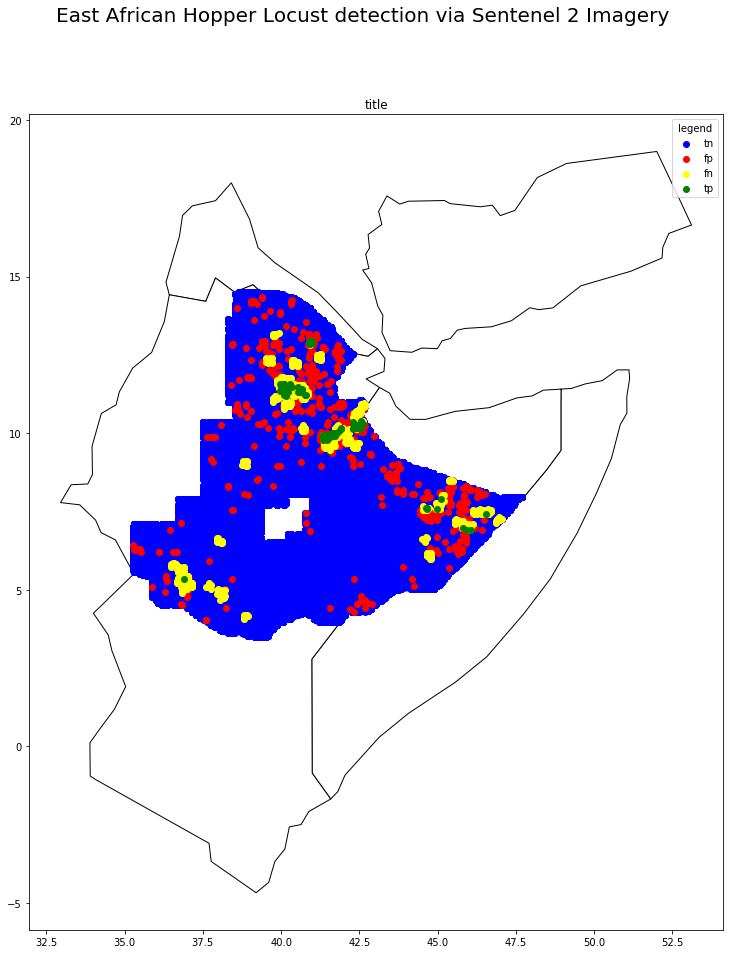

In [8]:
N = 1000
idx = pred_valid.argsort()[-N:][::-1]
y_hat = np.zeros(len(y_valid),)
y_hat[idx] = 1
tp, fp, tn, fn = get_conf(y_hat, y_valid)
df_val = df_label.iloc[idx_valid]
df_val['tp'] = tp.astype('int').copy()
df_val['fp'] = fp.astype('int').copy()
df_val['tn'] = tn.astype('int').copy()
df_val['fn'] = fn.astype('int').copy()
plot_map(df_val, 'title')

# Results from repeated execution of this experiment
- vs. Random Guess
- vs. Persistence (predict past geohashes to be locations where future geohashes will occur)
- Vary number of neighbors to include as positive and random split seed

In [9]:
#metrics_svm_clean = pd.read_csv('/home/ebarnett/locusts/experiments/svm_results_clean.csv')

with open('/home/ebarnett/locusts/experiments/metrics_svm.json', 'r') as f:
    metrics_svm = json.load(f)

with open('/home/ebarnett/locusts/experiments/metrics_rand.json', 'r') as f:
    metrics_rand = json.load(f)

with open('/home/ebarnett/locusts/experiments/metrics_pr.json', 'r') as f:
    metrics_pr = json.load(f)

metrics_rand = pd.DataFrame(metrics_rand)
metrics_pr = pd.DataFrame(metrics_pr)
metrics_svm = pd.DataFrame(metrics_svm)
metrics_svm

,top5,top10,top50,top100,top500,top1000,valid_auc,tp,fp,tn,fn,prec,rec,seed,train_size,n_neighbor
0,0.0,0.0,0.02,0.01,0.010,0.011,0.661911,91.0,235736.0,347512.0,34.0,0.000386,0.728000,0,0.1,0
1,0.0,0.0,0.08,0.05,0.018,0.013,0.674583,102.0,295384.0,223059.0,9.0,0.000345,0.918919,0,0.2,0
2,0.0,0.0,0.06,0.08,0.036,0.021,0.693296,87.0,231498.0,222140.0,10.0,0.000376,0.896907,0,0.3,0
3,0.4,0.2,0.06,0.04,0.028,0.023,0.583393,69.0,269984.0,54043.0,0.0,0.000256,1.000000,0,0.5,0
4,0.4,0.2,0.08,0.05,0.022,0.018,0.813836,36.0,44613.0,149803.0,6.0,0.000806,0.857143,0,0.7,0
5,0.6,0.5,0.18,0.12,0.068,0.055,0.726097,324.0,221948.0,361036.0,65.0,0.001458,0.832905,0,0.1,1
6,1.0,0.6,0.18,0.12,0.080,0.062,0.723234,306.0,226936.0,291272.0,40.0,0.001347,0.884393,0,0.2,1
7,0.8,0.4,0.16,0.16,0.096,0.065,0.581583,301.0,377947.0,75486.0,1.0,0.000796,0.996689,0,0.3,1
8,0.6,0.3,0.14,0.12,0.086,0.060,0.812732,144.0,13345.0,310535.0,72.0,0.010675,0.666667,0,0.5,1
9,0.4,0.3,0.14,0.12,0.072,0.046,0.522135,130.0,185725.0,8603.0,0.0,0.000699,1.000000,0,0.7,1


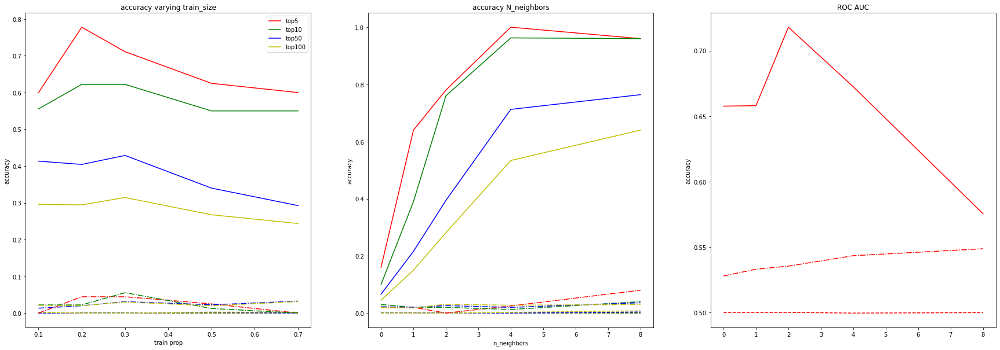

In [10]:
import matplotlib.pyplot as plt

f, ax = plt.subplots(1,3,figsize=(30,10))

ax[0].set_title('accuracy varying train_size')
ax[0].set_xlabel('train prop')
ax[0].set_ylabel('accuracy')

ax[0].plot(metrics_svm.groupby(['train_size']).mean().top5, c='r', label='top5')
ax[0].plot(metrics_svm.groupby(['train_size']).mean().top10, c = 'g', label='top10')
ax[0].plot(metrics_svm.groupby(['train_size']).mean().top50, c = 'b', label='top50')
ax[0].plot(metrics_svm.groupby(['train_size']).mean().top100, c = 'y',label='top100')
ax[0].legend()

ax[0].plot(metrics_rand.groupby(['train_size']).mean().top5, c='r', linestyle='--')
ax[0].plot(metrics_rand.groupby(['train_size']).mean().top10, c = 'g', linestyle='--')
ax[0].plot(metrics_rand.groupby(['train_size']).mean().top50, c = 'b', linestyle='--')
ax[0].plot(metrics_rand.groupby(['train_size']).mean().top100, c = 'y', linestyle='--')

ax[0].plot(metrics_pr.groupby(['train_size']).mean().top5, c='r', linestyle='-.')
ax[0].plot(metrics_pr.groupby(['train_size']).mean().top10, c = 'g', linestyle='-.')
ax[0].plot(metrics_pr.groupby(['train_size']).mean().top50, c = 'b', linestyle='-.')
ax[0].plot(metrics_pr.groupby(['train_size']).mean().top100, c = 'y', linestyle='-.')

ax[1].set_ylabel('accuracy')
ax[1].set_title('accuracy N_neighbors')
ax[1].set_xlabel('n_neighbors')
ax[1].plot(metrics_svm.groupby(['n_neighbor']).mean().top5, c='r')
ax[1].plot(metrics_svm.groupby(['n_neighbor']).mean().top10, c = 'g')
ax[1].plot(metrics_svm.groupby(['n_neighbor']).mean().top50, c = 'b')
ax[1].plot(metrics_svm.groupby(['n_neighbor']).mean().top100, c = 'y')

ax[1].plot(metrics_rand.groupby(['n_neighbor']).mean().top5, c='r', linestyle='--')
ax[1].plot(metrics_rand.groupby(['n_neighbor']).mean().top10, c = 'g', linestyle='--')
ax[1].plot(metrics_rand.groupby(['n_neighbor']).mean().top50, c = 'b', linestyle='--')
ax[1].plot(metrics_rand.groupby(['n_neighbor']).mean().top100, c = 'y', linestyle='--')

ax[1].plot(metrics_pr.groupby(['n_neighbor']).mean().top5, c='r', linestyle='-.')
ax[1].plot(metrics_pr.groupby(['n_neighbor']).mean().top10, c = 'g', linestyle='-.')
ax[1].plot(metrics_pr.groupby(['n_neighbor']).mean().top50, c = 'b', linestyle='-.')
ax[1].plot(metrics_pr.groupby(['n_neighbor']).mean().top100, c = 'y', linestyle='-.')

ax[2].set_ylabel('accuracy')
ax[2].set_title('ROC AUC')
ax[2].plot(metrics_svm.groupby(['n_neighbor']).mean().valid_auc, c='r')
ax[2].plot(metrics_rand.groupby(['n_neighbor']).mean().valid_auc, c='r', linestyle='--')
ax[2].plot(metrics_pr.groupby(['n_neighbor']).mean().valid_auc, c='r', linestyle='-.')


# Experiment: Time Series train / predict

In [ ]:
df_label = get_labels(df_meta, df_hoppers, 'hoppers', n_neighbor=2)
y = df_label['hoppers'].values

split_date = '2019-10-01'
idx_valid = np.array(list(df_label.index[df_label.date > split_date]))
idx_train = np.delete(np.arange(Xn.shape[0]), idx_valid)

X_train, X_valid, y_train, y_valid = Xn[idx_train], Xn[idx_valid], y[idx_train], y[idx_valid]


In [ ]:
model = LinearSVC(C=20, max_iter=1000).fit(X_train, y_train)
pred_valid = model.decision_function(X_valid)
pred_train = model.decision_function(X_train)
thresh = np.median(pred_train[y_train])
metrics_dict = get_metrics(pred_valid, y_valid, thresh)
print(metrics_dict)




In [ ]:
# Check top N predicted geohash/dates
N = 50
top_idx = pred_valid.argsort()[-N:][::-1]
df_val  = df_label.iloc[idx_valid[top_idx]]
df_train = df_label.iloc[idx_train]
df_train.loc[df_train['geohash'].isin(df_val['geohash'])]

df_val

# Check what is being predicted - is it just the same locs? / is there leakage?

In [ ]:
# Plot full sequence of a given example
row_sample = df_val.loc[df_val['hoppers']==1]
gh = row_sample['geohash'].iloc[0]
dt = row_sample['date'].iloc[0]
d = df_label.loc[df_label['geohash'] == gh].sort_values(['date'], ascending=[1])
date_seq = []
for row in d.iterrows():
    date_seq.append({
        'event': row[1].hoppers,
        'path': row[1].path,
        'date': str(row[1].date)[0:10],
        'pred': (row[1].date == dt),
        'in_train': len(df_train.loc[df_train['date'] == row[1].date].loc[df_train['geohash']==row[1].geohash]),
        'hopper_in_train': len(df_train.loc[df_train['date'] == row[1].date].loc[df_train['geohash']==row[1].geohash].loc[df_train['hoppers']==1])
    })

plot_(date_seq, title=gh)


# Have a look at the map / Distribution of predictions

In [ ]:
N = 1000
idx = pred_valid.argsort()[-N:][::-1]
y_hat = np.zeros(len(y_valid),)
y_hat[idx] = 1
tp, fp, tn, fn = get_conf(y_hat, y_valid)
df_val = df_label.iloc[idx_valid]
df_val['tp'] = tp.astype('int').copy()
df_val['fp'] = fp.astype('int').copy()
df_val['tn'] = tn.astype('int').copy()
df_val['fn'] = fn.astype('int').copy()
plot_map(df_val, 'title')

# Results from repeated execution of this experiment
- vs. Random Guess
- vs. Persistence (predict past geohashes to be locations where future geohashes will occur)
- Vary number of neighbors to include as positive and random split seed

In [ ]:
#metrics_svm_clean = pd.read_csv('/home/ebarnett/locusts/experiments/svm_results_clean.csv')

with open('/home/ebarnett/locusts/experiments/metrics_svm_dates.json', 'r') as f:
    metrics_svm = json.load(f)

with open('/home/ebarnett/locusts/experiments/metrics_rand_dates.json', 'r') as f:
    metrics_rand = json.load(f)

with open('/home/ebarnett/locusts/experiments/metrics_pr_dates.json', 'r') as f:
    metrics_pr = json.load(f)

metrics_rand = pd.DataFrame(metrics_rand)
metrics_pr = pd.DataFrame(metrics_pr)
metrics_svm = pd.DataFrame(metrics_svm)
metrics_svm

In [ ]:
import matplotlib.pyplot as plt

f, ax = plt.subplots(1,3,figsize=(30,10))

ax[0].set_title('accuracy varying train_size')
ax[0].set_xlabel('train prop')
ax[0].set_ylabel('accuracy')

ax[0].plot(metrics_svm.groupby(['train_size']).mean().top5, c='r', label='top5')
ax[0].plot(metrics_svm.groupby(['train_size']).mean().top10, c = 'g', label='top10')
ax[0].plot(metrics_svm.groupby(['train_size']).mean().top50, c = 'b', label='top50')
ax[0].plot(metrics_svm.groupby(['train_size']).mean().top100, c = 'y',label='top100')
ax[0].legend()

ax[0].plot(metrics_rand.groupby(['train_size']).mean().top5, c='r', linestyle='--')
ax[0].plot(metrics_rand.groupby(['train_size']).mean().top10, c = 'g', linestyle='--')
ax[0].plot(metrics_rand.groupby(['train_size']).mean().top50, c = 'b', linestyle='--')
ax[0].plot(metrics_rand.groupby(['train_size']).mean().top100, c = 'y', linestyle='--')

ax[0].plot(metrics_pr.groupby(['train_size']).mean().top5, c='r', linestyle='-.')
ax[0].plot(metrics_pr.groupby(['train_size']).mean().top10, c = 'g', linestyle='-.')
ax[0].plot(metrics_pr.groupby(['train_size']).mean().top50, c = 'b', linestyle='-.')
ax[0].plot(metrics_pr.groupby(['train_size']).mean().top100, c = 'y', linestyle='-.')

ax[1].set_ylabel('accuracy')
ax[1].set_title('accuracy N_neighbors')
ax[1].set_xlabel('n_neighbors')


ax[2].set_ylabel('accuracy')
ax[2].set_title('ROC AUC')
ax[2].plot(metrics_svm.groupby(['n_neighbor']).mean().valid_auc, c='r')
ax[2].plot(metrics_rand.groupby(['n_neighbor']).mean().valid_auc, c='r', linestyle='--')
ax[2].plot(metrics_pr.groupby(['n_neighbor']).mean().valid_auc, c='r', linestyle='-.')
